# Collegamento Drive

In [20]:
from google.colab import drive
drive.mount("/content/drive", force_remount=True)

!ls '/content/drive/My Drive/SonART/Demo'

Mounted at /content/drive
'asmr EGG CRACKING sound.mp3'
'Bird Flapping Wings Sound Effect.mp3'
'Busy Street [Sound Effect].mp3'
 cat-purring-68797.mp3
 egg-crack5-104555.mp3
 egg-cracking-6844.mp3
'Egg Shell Crack Sound Effect - Egg Cracking sound.mp3'
'Heart Beat [SOUND EFFECT].mp3'
'Hungry Cat Sound Effects - Hungry Cat Meowing Sound shorts.mp3'
'Long Mud Pour Sound Effect.mp3'
'Meow Sound Effect.mp3'
' Royalty-Free Sounds.mp3'
'Seagull - Sound Effect.mp3'
'seagull sound.mp3'
'Sea Waves - Sound Effect.mp3'
'SonART Demo v1.wav'
'SonART Demo v2.wav'
'SonART Demo v3.wav'
'SonART Demo v4.wav'
'SonART Demo v5.wav'
'SonART Demo v6.wav'
'SonART Demo v7.wav'
'SonART Demo v8.wav'
'Sound effect - Campane - Bells.mp3'
 splash-6213.mp3


# Import

In [2]:
%pip install --quiet --upgrade diffusers transformers accelerate mediapy peft

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 106.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.7/354.7 kB 24.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 411.0/411.0 kB 27.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 65.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 34.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 41.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [3]:
!pip install torchlibrosa

In [4]:
import os
import sys
import matplotlib.pyplot as plt
import numpy as np
import librosa
import torch
import datetime
import time

In [8]:
path = "/content/drive/MyDrive/SonART/Code"
if os.path.exists(path):
    print("La cartella esiste!")
else:
    print("Errore: La cartella non è stata trovata. Controlla il percorso.")

La cartella esiste!


In [9]:
sys.path.append("/content/drive/MyDrive/SonART/Code")

In [10]:
from panns_inference import AudioTagging, SoundEventDetection, labels

# Recupero modello audio dal Drive

In [24]:
# Percorso del modello su Drive
checkpoint_model = "/content/drive/My Drive/SonART/saved_model/panns/panns_model.pth"

# Carica il modello salvato
model = torch.load(checkpoint_model, map_location="cuda" if torch.cuda.is_available() else "cpu", weights_only=False)

# Scarica modello immagini

In [12]:
import torch
from diffusers import LCMScheduler, AutoPipelineForText2Image
import mediapy as media
import random
import sys
import torch

model_id = "stabilityai/stable-diffusion-xl-base-1.0"
adapter_id = "latent-consistency/lcm-lora-sdxl"

pipe = AutoPipelineForText2Image.from_pretrained(model_id, torch_dtype=torch.float16, variant="fp16")
pipe.scheduler = LCMScheduler.from_config(pipe.scheduler.config)
pipe.to("cuda")

# load and fuse lcm lora
pipe.load_lora_weights(adapter_id)
pipe.fuse_lora()

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'skip_prk_steps': True} were passed to LCMScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


pytorch_lora_weights.safetensors:   0%|          | 0.00/394M [00:00<?, ?B/s]

# Scelta audio e divisione in segmenti

In [13]:
audio_path = '/content/drive/My Drive/SonART/Demo/SonART Demo v8.wav'
audio, sr = librosa.load(audio_path, sr=32000, mono=True)

In [14]:
# **Specifica la durata dei segmenti in secondi**
segment_duration = 3 # Durata del segmento in secondi (esempio: 2 secondi)
hop_duration = 1   # Durata del salto tra segmenti in secondi (esempio: 1 secondo)
time_stamps = np.arange(0, len(audio)/sr, hop_duration)

# Calcolare la lunghezza di ogni segmento in campioni
segment_length = int(segment_duration * 32000)
hop_length = int(hop_duration * 32000)

# Dividere il waveform in segmenti con il salto specificato
segments = []
for start in range(0, len(audio) - segment_length + 1, hop_length):
    segment = audio[start:start + segment_length]
    segments.append(segment)

# Aggiungere l'ultimo segmento se non coperto dal ciclo (padding se necessario)
if len(audio) % hop_length != 0:
    last_segment = audio[-segment_length:]
    segments.append(last_segment)

# Trasformare i segmenti in un array numpy
segments = np.stack(segments)

# Mostrare dettagli
print(f"Numero di segmenti: {len(segments)}, Forma di ogni segmento: {segments[0].shape}")

Numero di segmenti: 96, Forma di ogni segmento: (96000,)


In [15]:
from IPython.display import Audio
Audio(audio, rate=32000)

# Utilizzo modello audio + immagini

In [16]:
def best_tag(clipwise_output):
    """Visualization of audio tagging result.

    Args:
      clipwise_output: (classes_num,)
    """
    sorted_indexes = np.argsort(clipwise_output)[::-1]

    return sorted_indexes[0]

In [17]:
class ObservableList(list):
    def append(self, item, i, last_event):
        super().append(item)  # Chiamata originale
        self.on_append(item, i, last_event)
    def on_append(self, item, i, last_event):
        prompt = item + ' 8k'
        image = pipe(prompt=prompt, num_inference_steps=5, guidance_scale=0).images[0]

        if(i != 1):
          time.sleep(time_stamps[i] - time_stamps[last_event])
        media.show_images([image])

**Se non avete già un modello nel percorso allora passate model=None**

In [27]:
checkpoint_path = '/content/drive/My Drive/SonART/saved_model/panns/Cnn14_mAP=0.431.pth' #percorso pesi
checkpoint_model = '/content/drive/My Drive/SonART/saved_model/panns/panns_model.pth'

device = 'cuda' # 'cuda' | 'cpu'
at = AudioTagging(model=None, checkpoint_path=checkpoint_path, checkpoint_model=checkpoint_model, device=device)

Checkpoint path: /content/drive/My Drive/SonART/saved_model/panns/Cnn14_mAP=0.431.pth
✅ La cartella esiste già: /content/drive/My Drive/SonART/saved_model/panns
✅ Il file esiste già, nessun download necessario.
Checkpoint model: /content/drive/My Drive/SonART/saved_model/panns/panns_model.pth
💾 Modello istanziato salvato su Drive: /content/drive/My Drive/SonART/saved_model/panns/panns_model.pth
GPU number: 1


Waves, surf: 0.720
0:00:01


  0%|          | 0/5 [00:00<?, ?it/s]

""

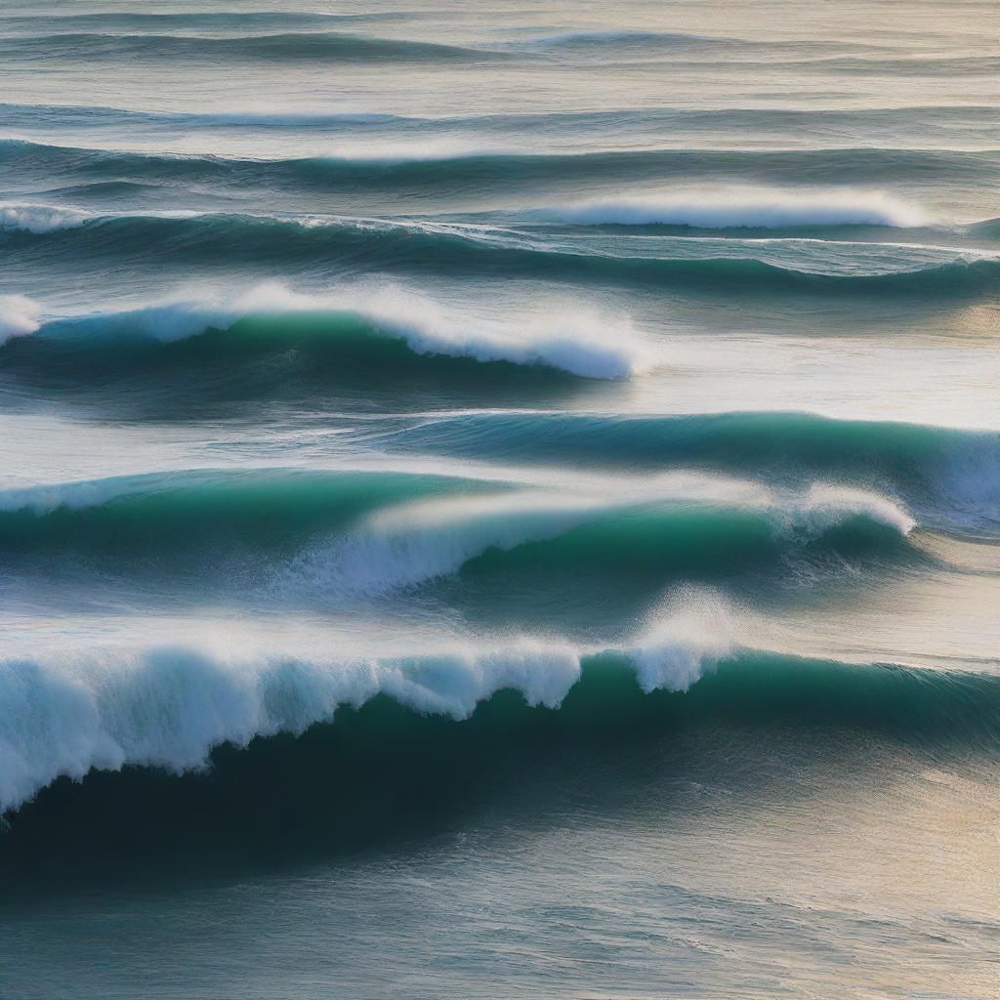

Honk: 0.694
0:00:14


  0%|          | 0/5 [00:00<?, ?it/s]

""

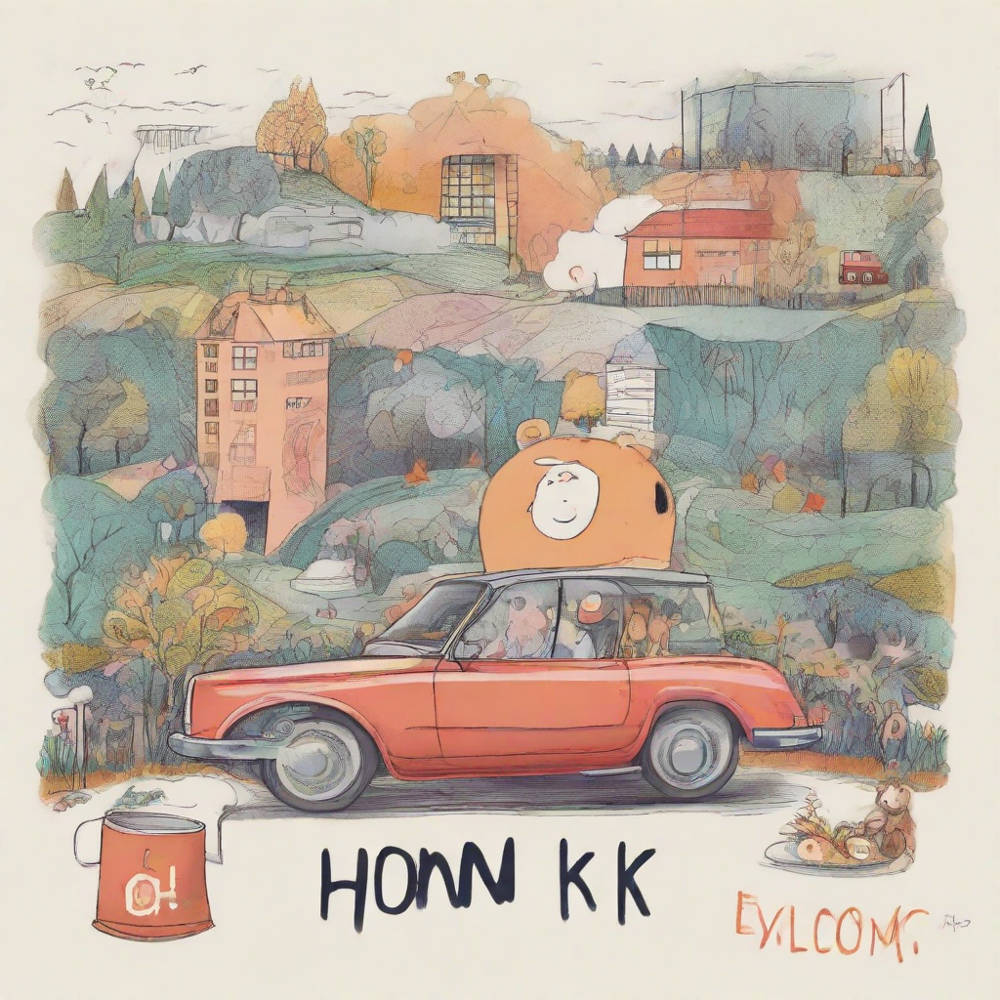

Owl: 0.586
0:00:20


  0%|          | 0/5 [00:00<?, ?it/s]

""

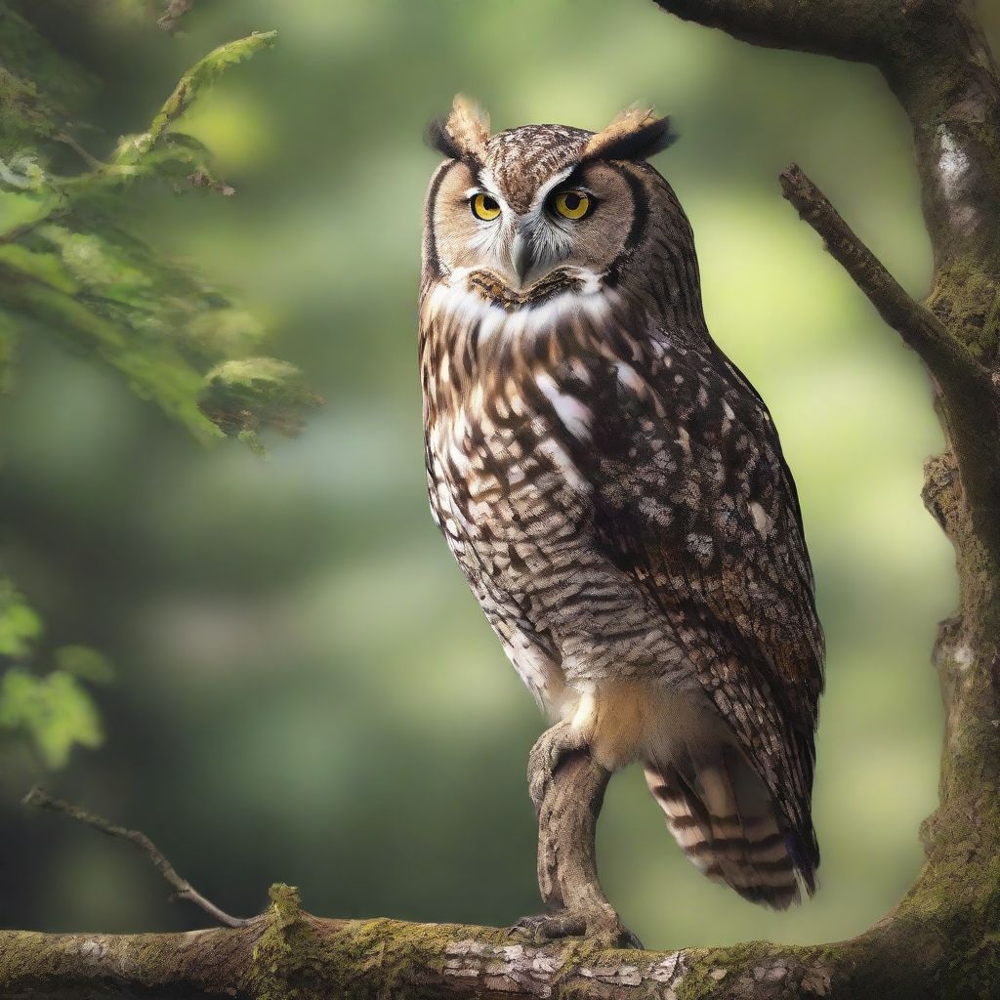

Honk: 0.715
0:00:23


  0%|          | 0/5 [00:00<?, ?it/s]

""

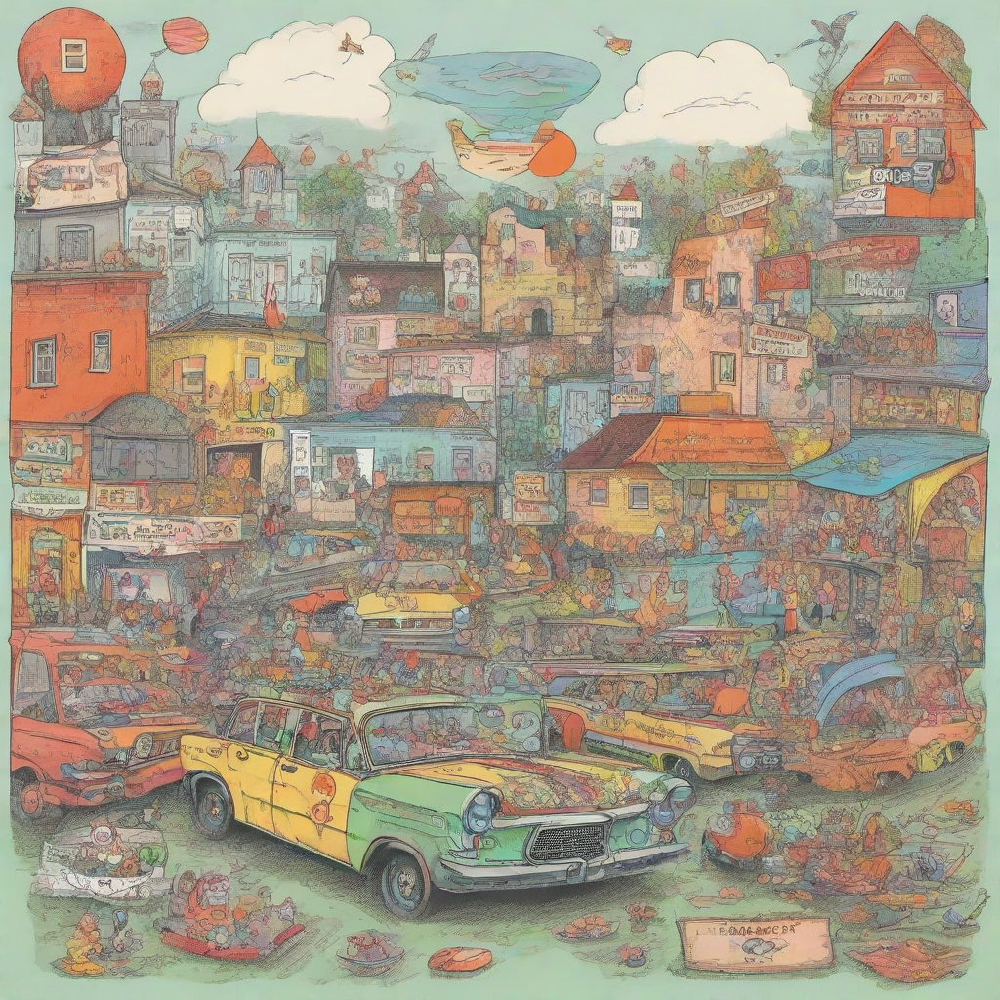

Goose: 0.633
0:00:26


  0%|          | 0/5 [00:00<?, ?it/s]

""

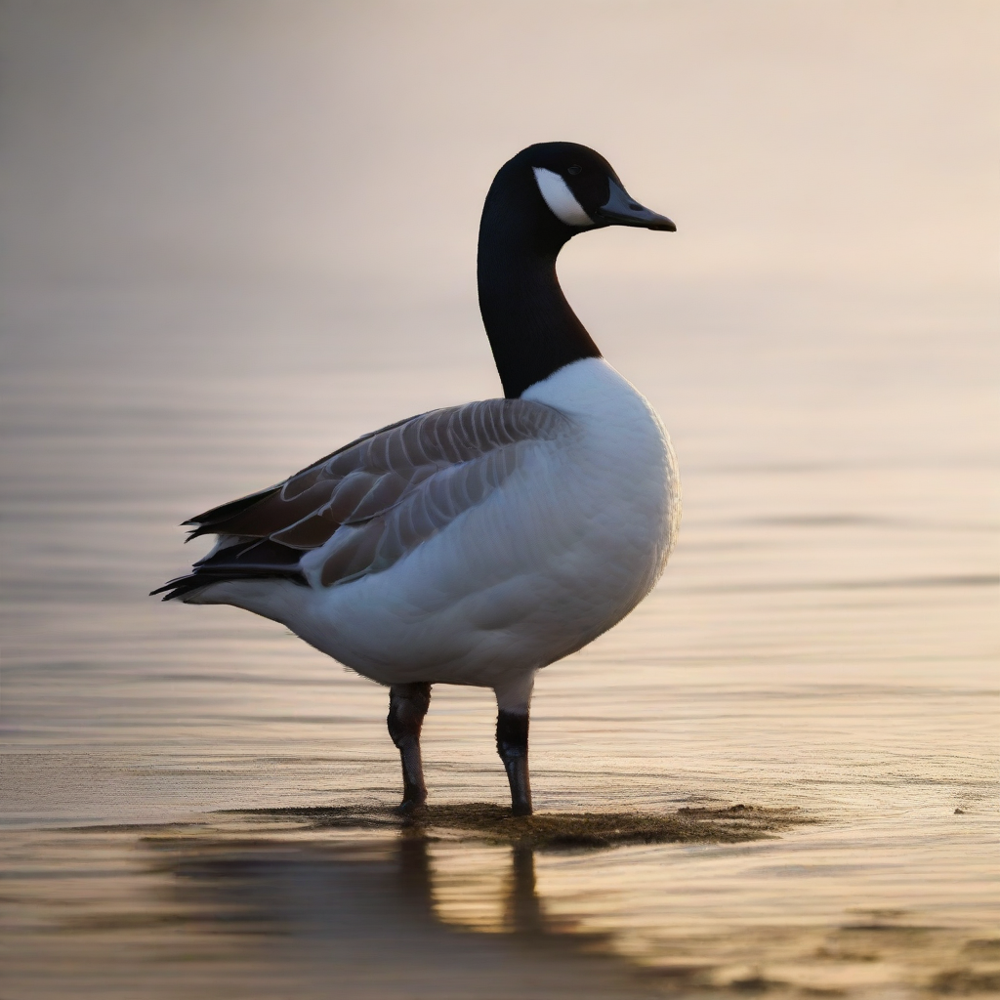

Bird: 0.727
0:00:40


  0%|          | 0/5 [00:00<?, ?it/s]

""

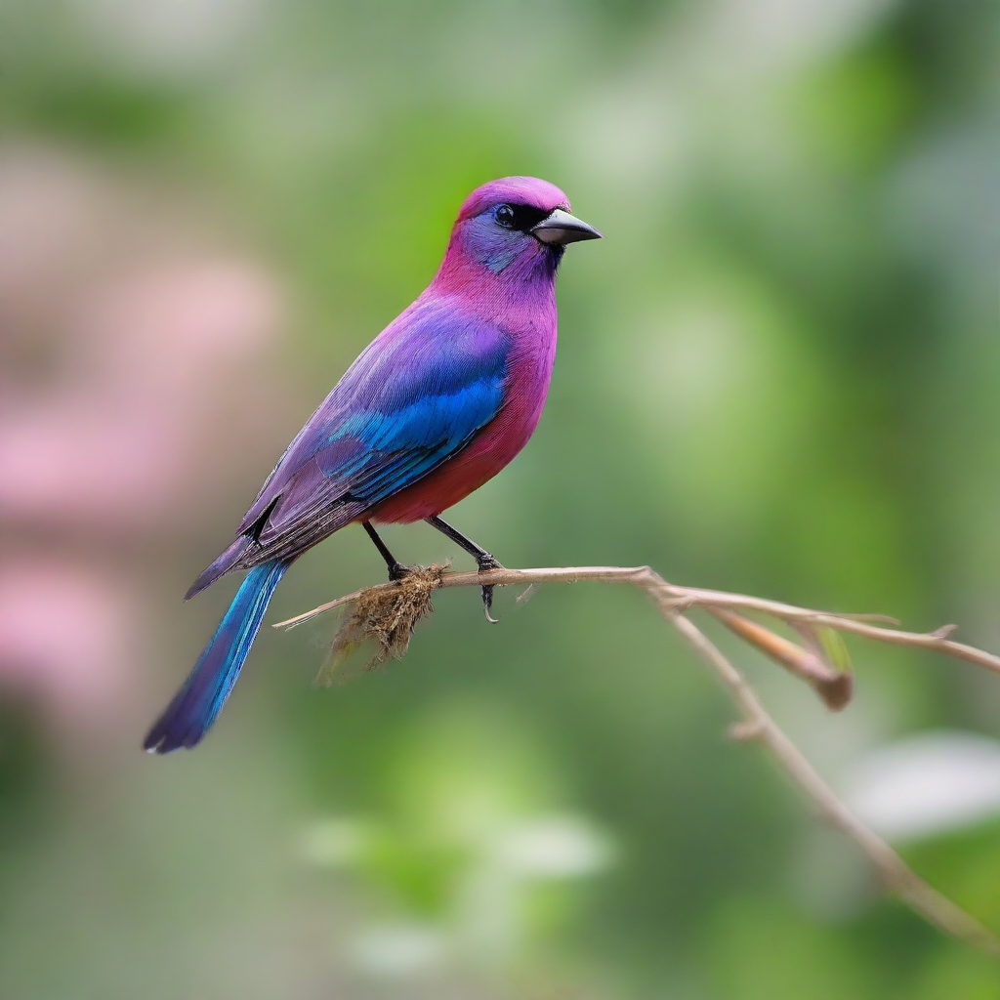

Vehicle: 0.719
0:00:44


  0%|          | 0/5 [00:00<?, ?it/s]

""

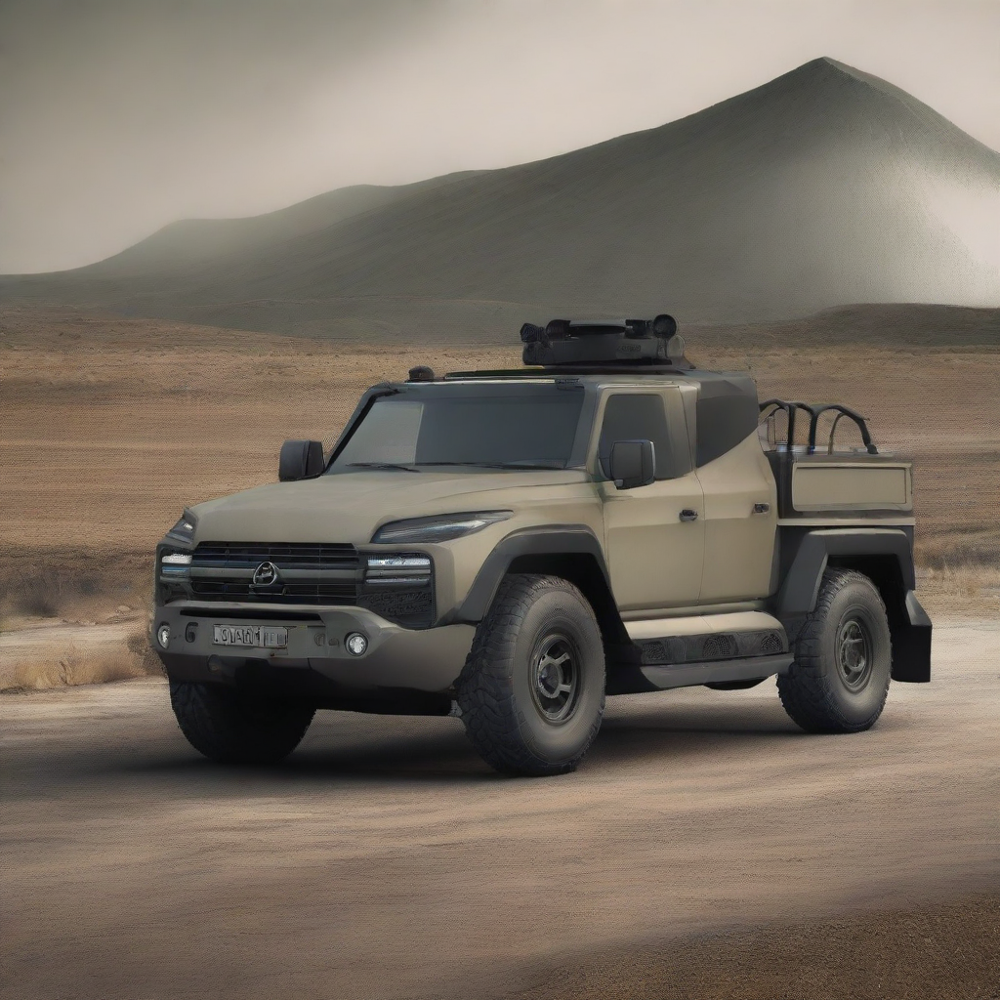

Cat: 0.919
0:00:47


  0%|          | 0/5 [00:00<?, ?it/s]

""

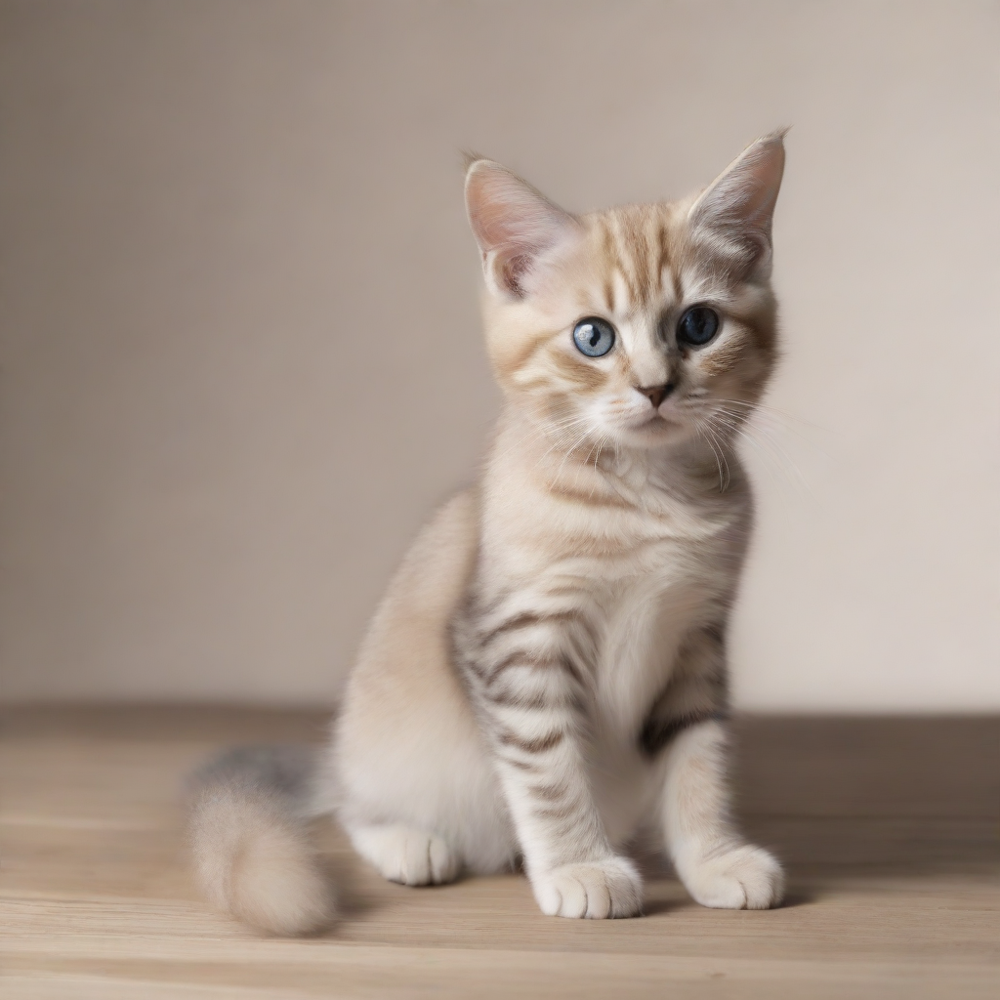

Pulse: 0.467
0:00:51


  0%|          | 0/5 [00:00<?, ?it/s]

""

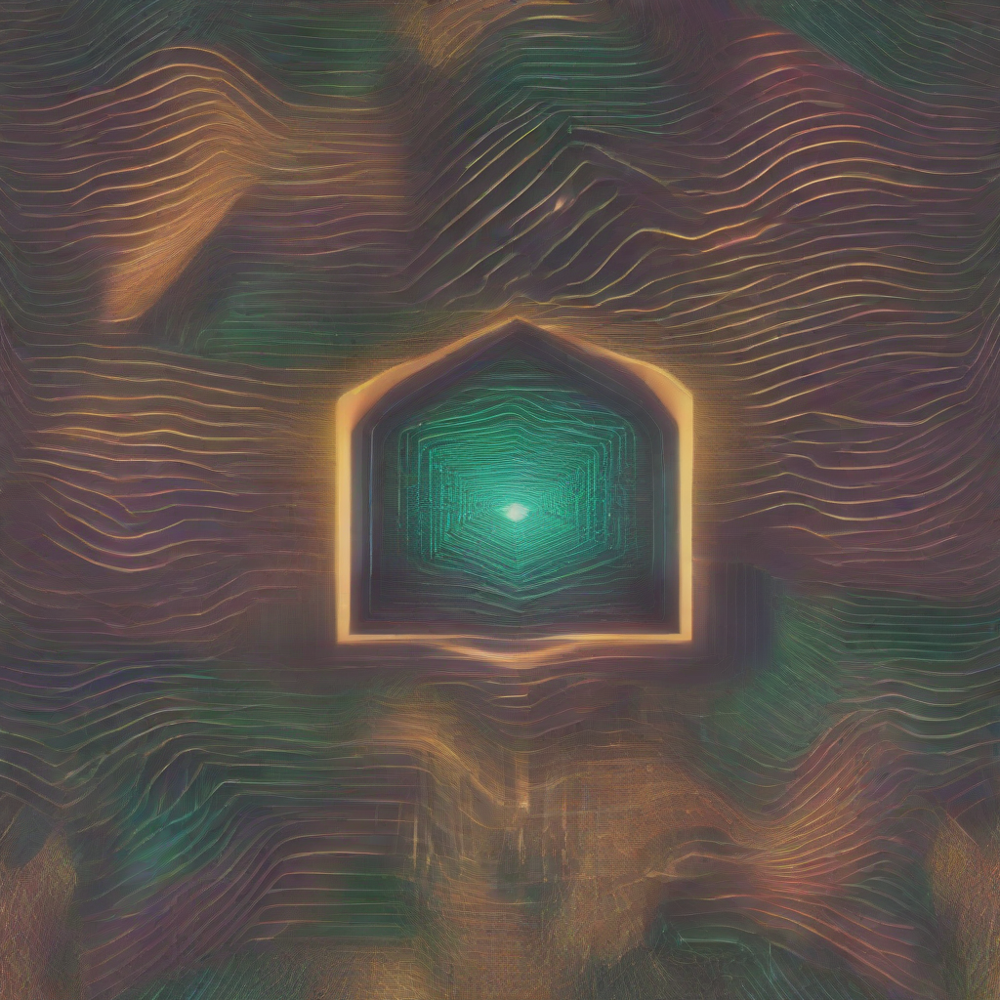

Waves, surf: 0.703
0:00:54


  0%|          | 0/5 [00:00<?, ?it/s]

""

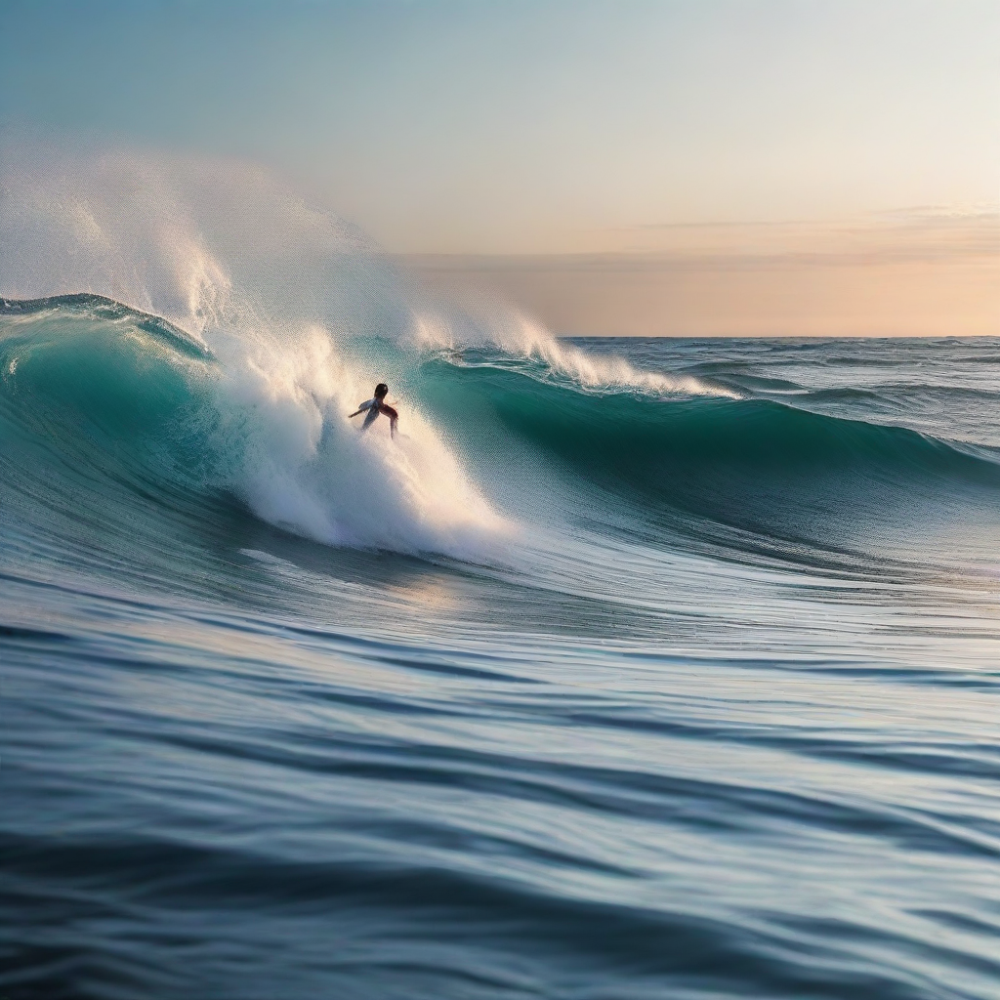

Purr: 0.568
0:01:04


  0%|          | 0/5 [00:00<?, ?it/s]

""

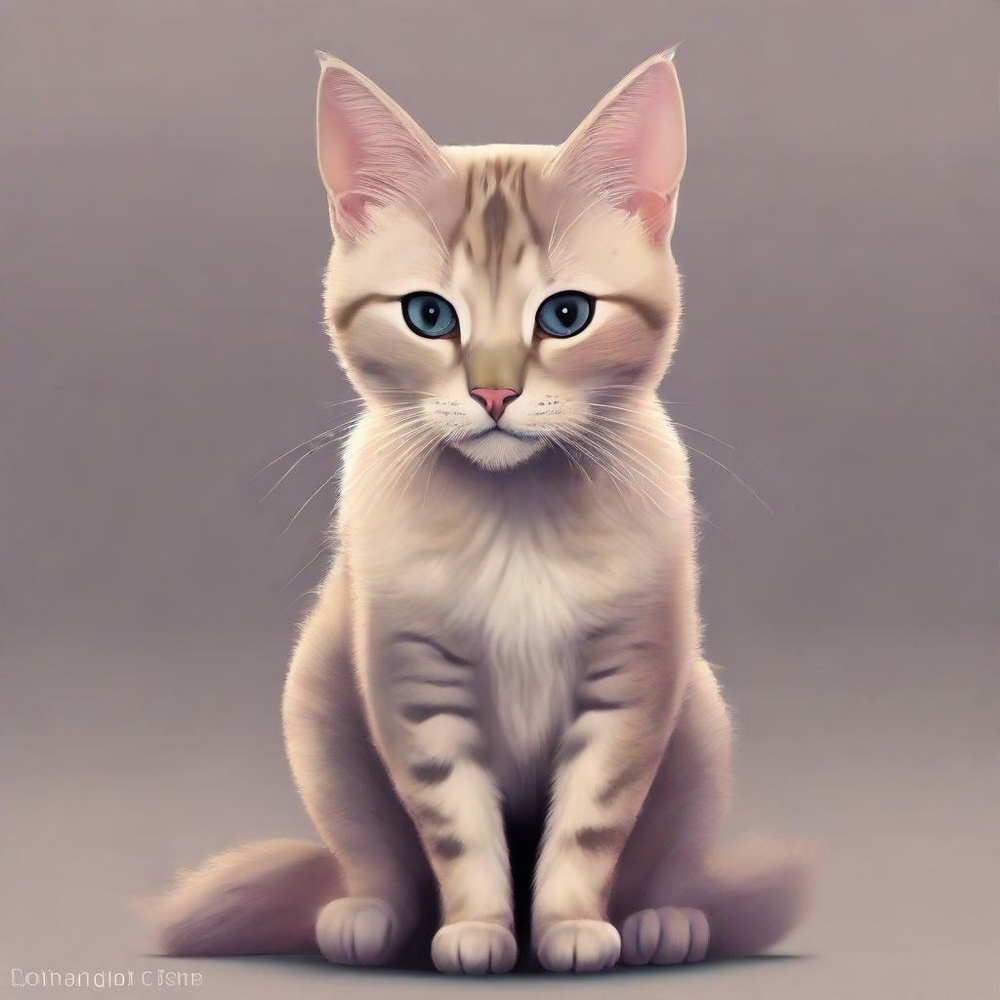

Honk: 0.771
0:01:14


  0%|          | 0/5 [00:00<?, ?it/s]

""

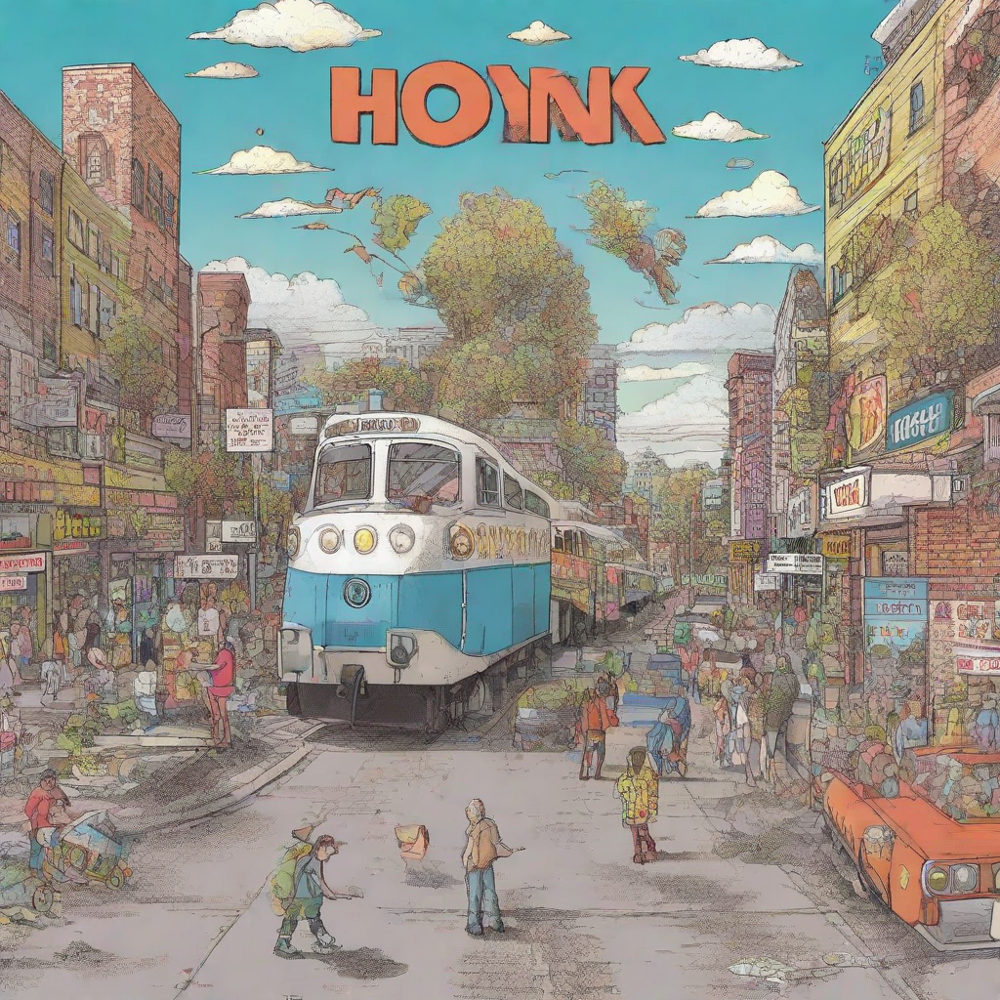

Cat: 0.706
0:01:16


  0%|          | 0/5 [00:00<?, ?it/s]

""

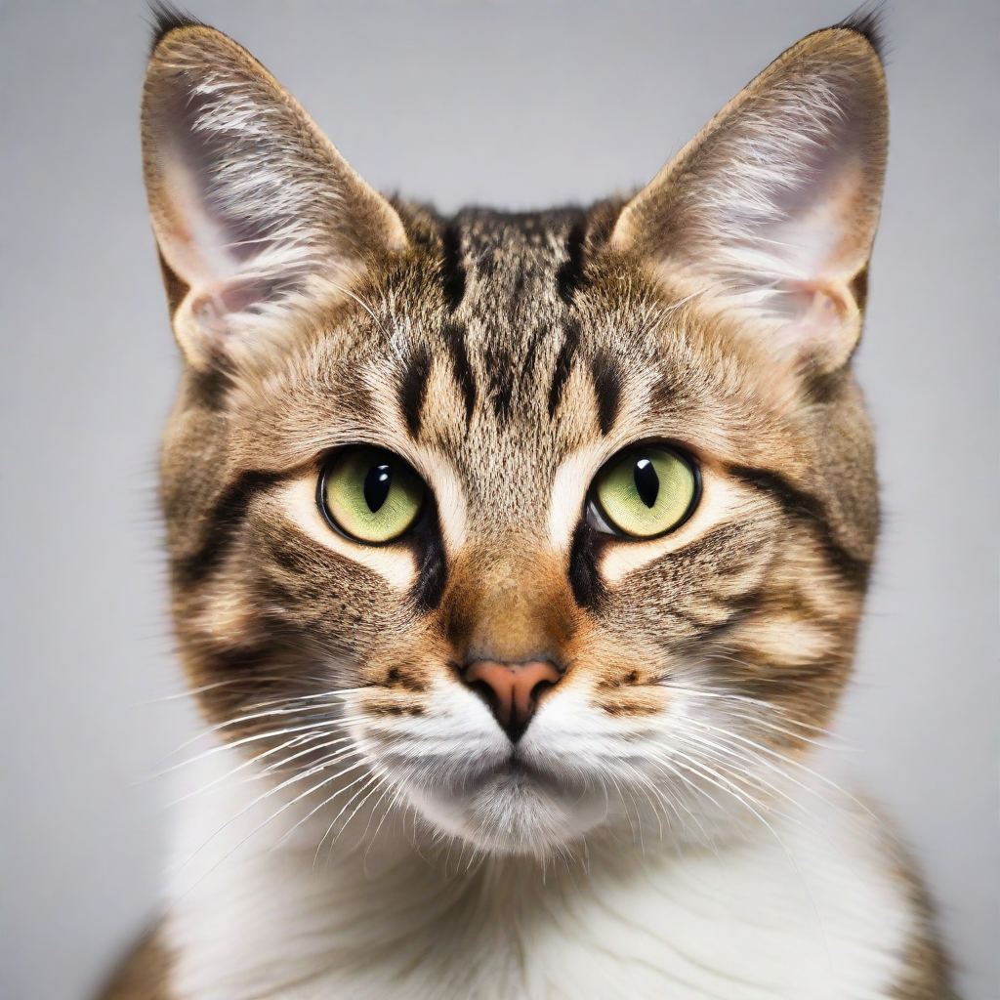

Church bell: 0.695
0:01:28


  0%|          | 0/5 [00:00<?, ?it/s]

""

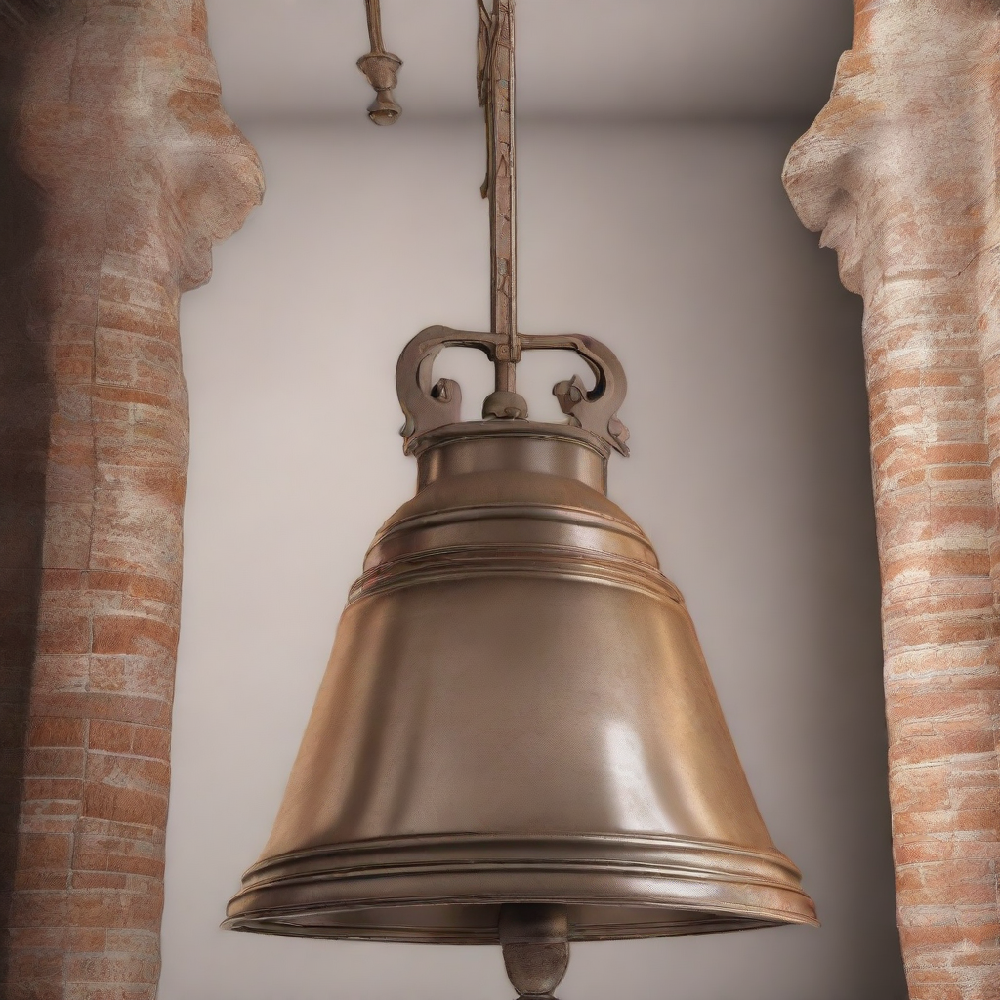

In [26]:
# Variabile per tracciare la parola precedentemente stampata
last_printed_word = None
# Variabile per tracciare la parola precedente all'iterazione attuale
previous_word = None

tag_list = ObservableList()
last_event = None

for i, segment in enumerate(segments):
  segment = segment[None, :]  # (batch_size, segment_samples)

  (clipwise_output, embedding) = at.inference(segment)
  """clipwise_output: (batch_size, classes_num), embedding: (batch_size, embedding_size)"""

  index = best_tag(clipwise_output[0])
  predicted_class = np.array(labels)[index]
  clipwise_output = clipwise_output[0]

  # Stampa solo se la parola si ripete almeno 2 volte di fila e non è la stessa della precedente
  if predicted_class == previous_word:
      if predicted_class != last_printed_word:
          if(clipwise_output[index] >= 0.400):
            print('{}: {:.3f}'.format(predicted_class,
            clipwise_output[index]))
            print(str(datetime.timedelta(seconds=time_stamps[i])))
            tag_list.append(predicted_class, i, last_event)
            last_printed_word = predicted_class  # Aggiorna l'ultima parola stampata
            last_event = i
  else:
      previous_word = predicted_class  # Aggiorna la parola precedente solo se non è la stessa